## CV Assignment 2 - Task 2

Name: Muhammad Fahad Waqar<br>
Student No: st125981

In [12]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
from torchvision.transforms import functional as F
from ultralytics import YOLO

import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
import os
import requests
from pathlib import Path

In [13]:
# Set device
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {DEVICE}")

Using device: cuda


In [14]:
# COCO Class Names
COCO_CLASSES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A',
    'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard',
    'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard',
    'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass', 'cup', 'fork',
    'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange',
    'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'N/A', 'dining table', 'N/A', 'N/A', 'toilet', 'N/A',
    'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave',
    'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book', 'clock', 'vase',
    'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

In [15]:
# Load Models
# Model 1: Faster R-CNN
print("Loading Faster R-CNN model...")
try:
    weights_frcnn = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
    model_frcnn = fasterrcnn_resnet50_fpn_v2(weights=weights_frcnn, box_score_thresh=0.5)
    model_frcnn.to(DEVICE)
    model_frcnn.eval()
    print("Faster R-CNN model loaded")
    preprocess_frcnn = weights_frcnn.transforms()

except Exception as e:
    print(f"Error loading Faster R-CNN model: {e}")
    model_frcnn = None

# Model 2: YOLOv8
print("Loading YOLOv8 model...")
try:
    model_yolo = YOLO('yolov8n.pt')
    model_yolo.to(DEVICE)
    if DEVICE.type == 'cuda':
        model_yolo(torch.zeros(1, 3, 640, 640).to(DEVICE))
    print("YOLOv8 model loaded")

except Exception as e:
    print(f"Error loading YOLOv8 model: {e}")
    model_yolo = None

Loading Faster R-CNN model...
Faster R-CNN model loaded
Loading YOLOv8 model...

0: 640x640 (no detections), 19.4ms
Speed: 0.0ms preprocess, 19.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)
YOLOv8 model loaded


In [16]:
print("Looking for local COCO-128 dataset...")
try:
    try:
        script_dir = Path(__file__).parent
    except NameError:
        script_dir = Path.cwd()

    dataset_dir = script_dir / 'data' / 'coco128'

    coco128_yaml_path = dataset_dir / 'coco128.yaml'
    val_image_dir = dataset_dir / 'images' / 'train2017'

    if not dataset_dir.exists():
        raise FileNotFoundError(f"Dataset directory not found at: {dataset_dir}")
    
    if not coco128_yaml_path.exists():
         raise FileNotFoundError(f"YAML file not found at: {coco128_yaml_path}")

    if not val_image_dir.exists():
        raise FileNotFoundError(f"Image directory not found at: {val_image_dir}")

    val_image_paths = sorted(list(val_image_dir.glob('*.jpg')))
    if not val_image_paths:
        raise FileNotFoundError(f"No images found in {val_image_dir}.")
        
    print(f"Local COCO-128 dataset found successfully.")
    print(f"Using {len(val_image_paths)} validation images from {val_image_dir}")

    # Select 10 images for visualization
    indices = np.linspace(0, len(val_image_paths) - 1, 10, dtype=int)
    vis_image_paths = [val_image_paths[i] for i in indices]

except Exception as e:
    print(f"Error loading local COCO-128 dataset: {e}")
    print("Please ensure your file structure matches the screenshot: 'notebooks/data/coco128'")
    # Set paths to empty so the script doesn't fail later, but warns
    vis_image_paths = []
    val_image_paths = []
    coco128_yaml_path = None

Looking for local COCO-128 dataset...
Local COCO-128 dataset found successfully.
Using 128 validation images from e:\Downloads\AIT\First Semeter\Computer Vision\Assignments\st125981_fahad_cv_assignments\Assignment 2\notebooks\data\coco128\images\train2017


In [17]:
def draw_detections(image, boxes, labels, scores, title=""):    # Draws bounding boxes on an image.
    # Convert PIL image to numpy array for drawing
    img_np = np.array(image)
    # Convert to BGR for OpenCV
    img_cv = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)
    
    for box, label, score in zip(boxes, labels, scores):
        if score < 0.5: # Confidence threshold
            continue
            
        xmin, ymin, xmax, ymax = map(int, box)
        
        # Generate a random color for the class
        color = np.random.randint(0, 255, 3).tolist()
        
        # Draw rectangle
        cv2.rectangle(img_cv, (xmin, ymin), (xmax, ymax), color, 2)
        
        # Draw text background
        text = f"{label}: {score:.2f}"
        (text_width, text_height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
        cv2.rectangle(img_cv, (xmin, ymin - text_height - baseline), (xmin + text_width, ymin), color, -1)
        
        # Draw text
        cv2.putText(img_cv, text, (xmin, ymin - baseline), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1)
        
    # Convert BGR back to RGB for Matplotlib
    img_rgb = cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)
    
    # Plot
    plt.figure(figsize=(10, 8))
    plt.imshow(img_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()

Processing image: 000000000009.jpg


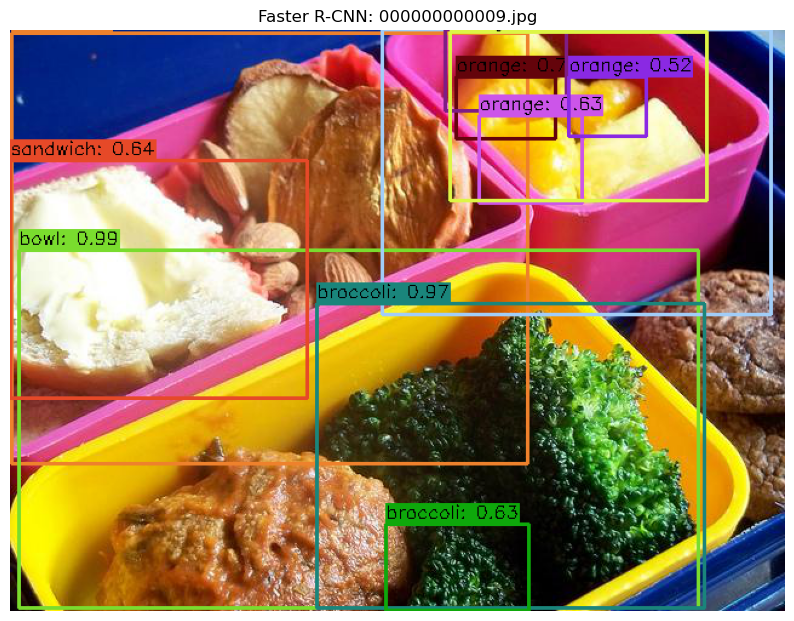

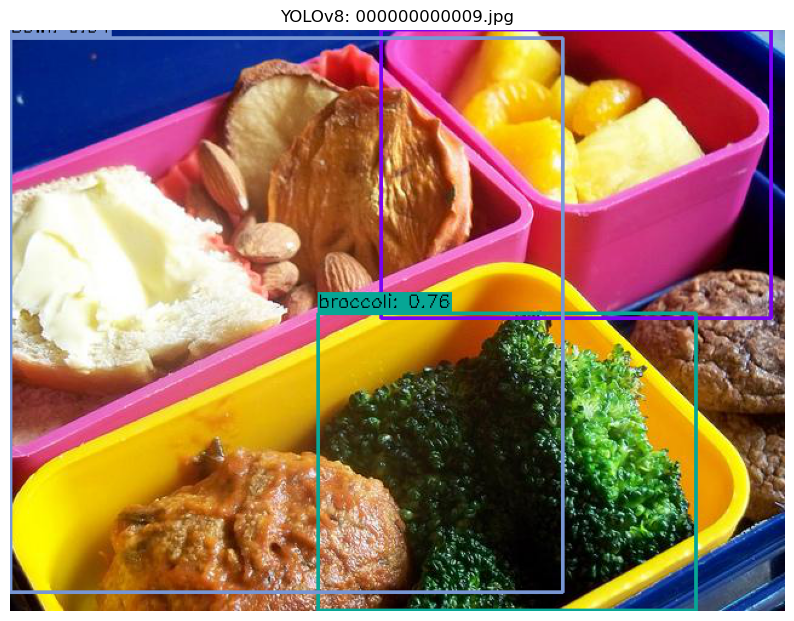

Processing image: 000000000078.jpg


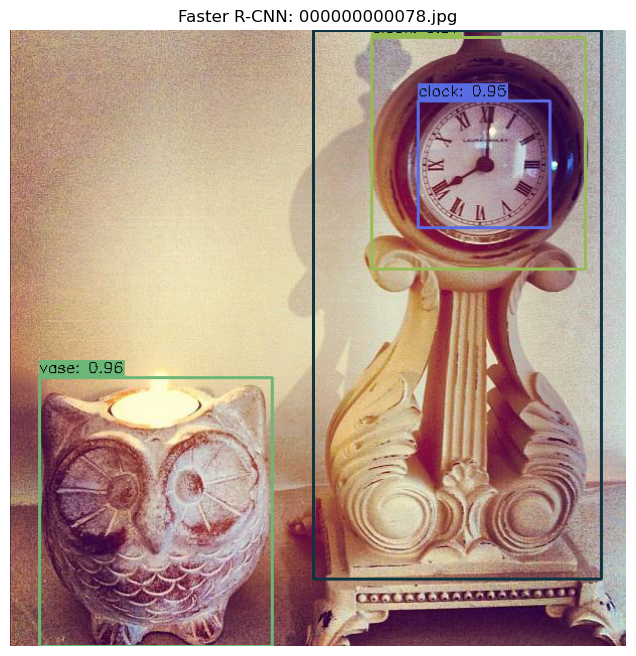

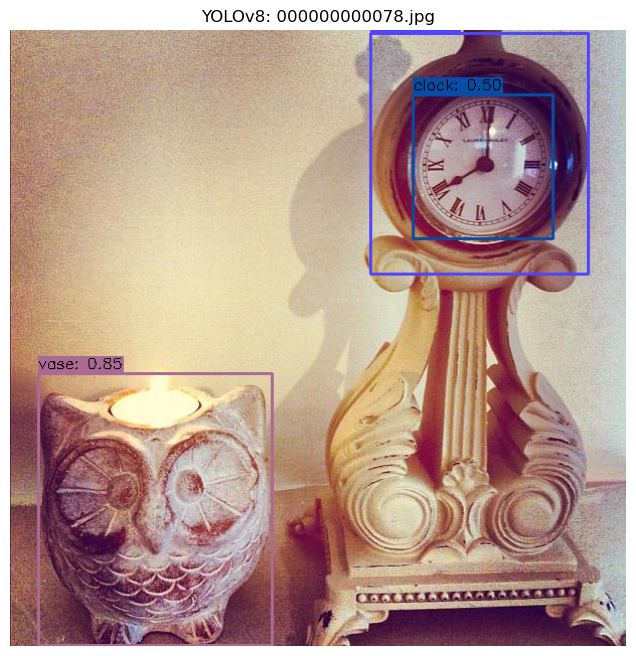

Processing image: 000000000143.jpg


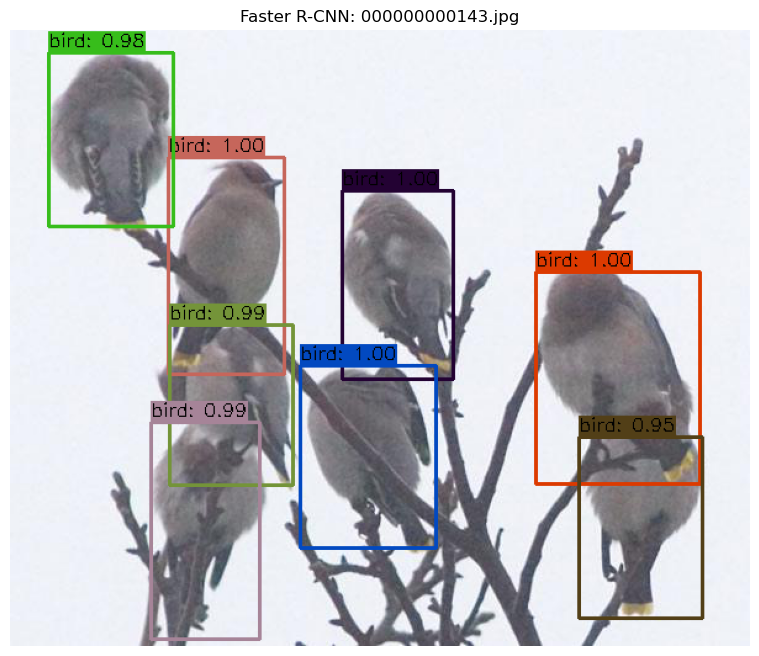

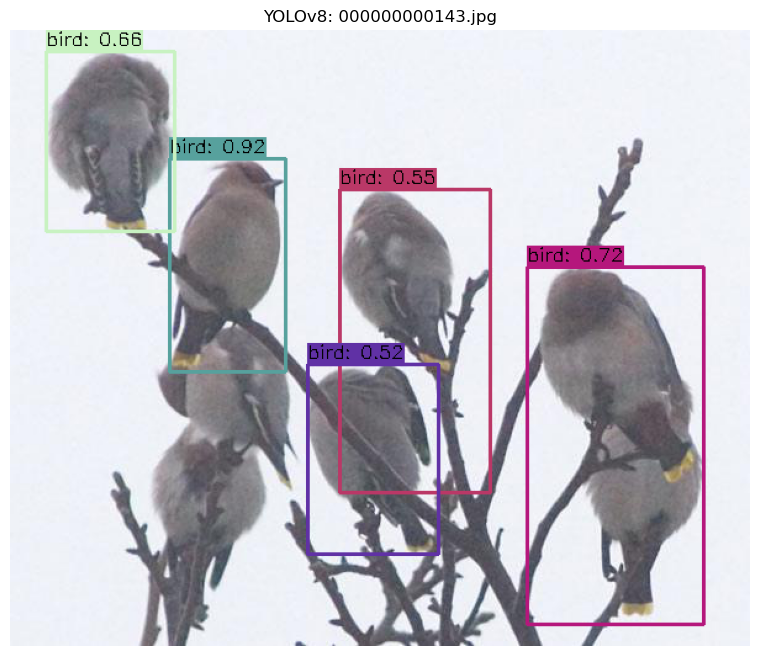

Processing image: 000000000250.jpg


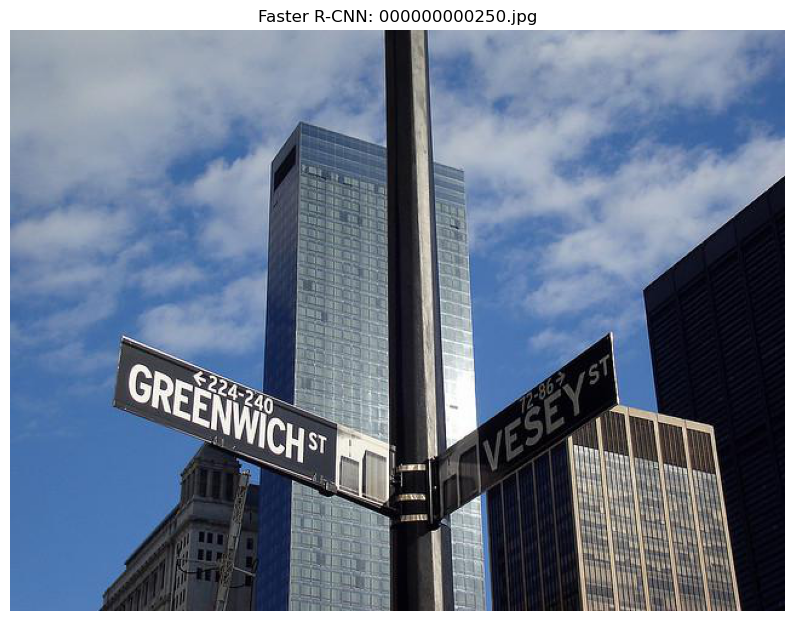

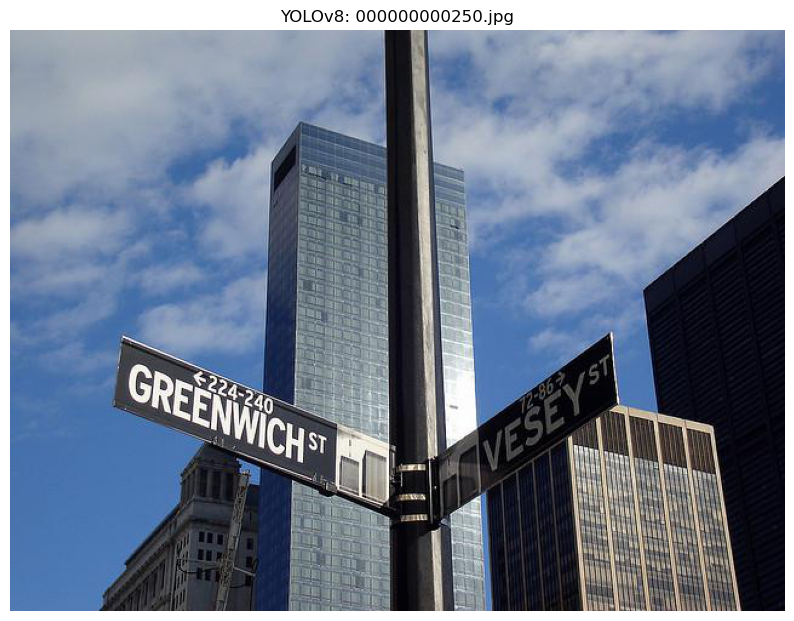

Processing image: 000000000328.jpg


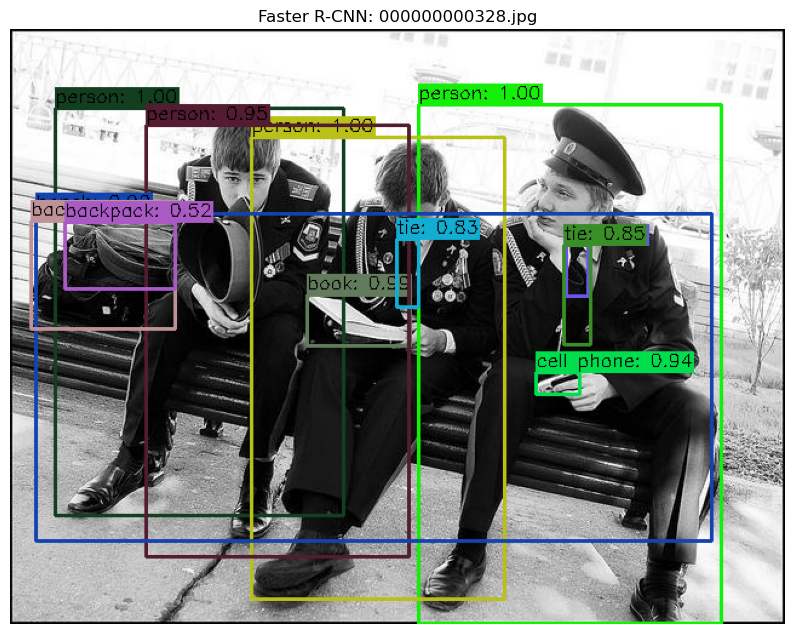

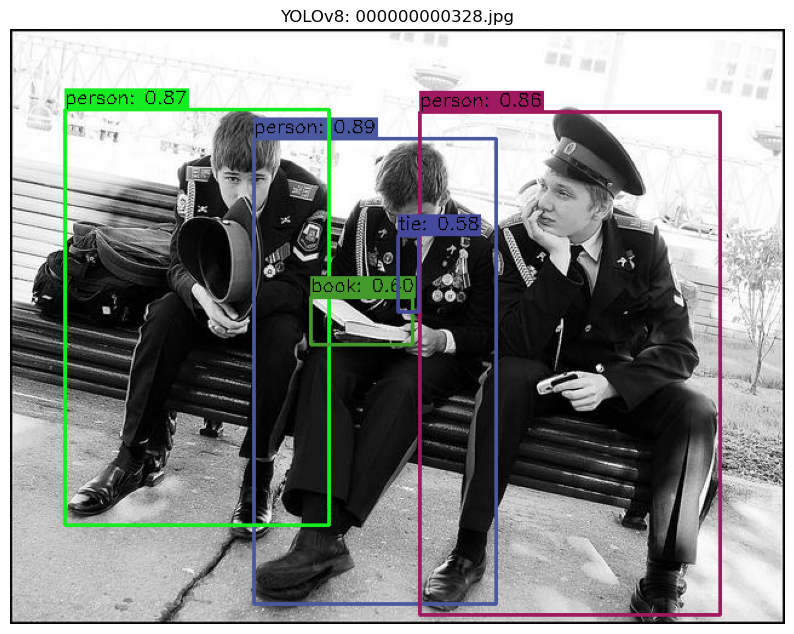

Processing image: 000000000395.jpg


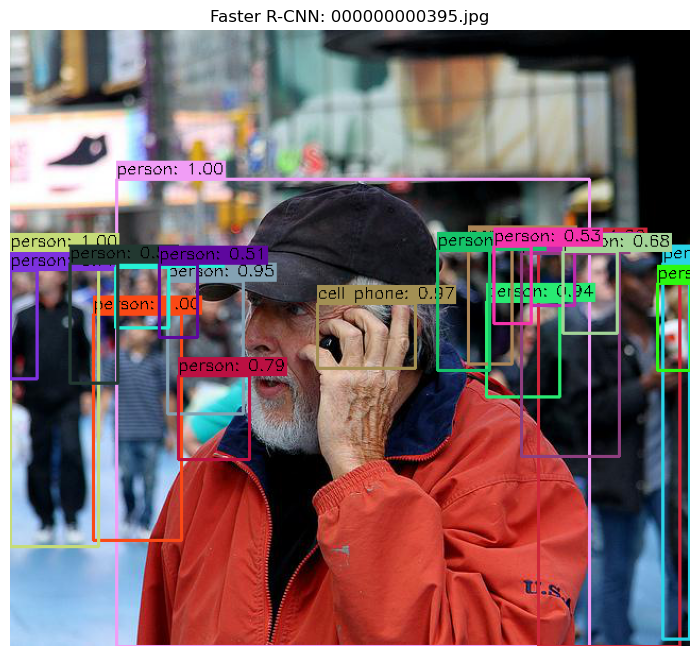

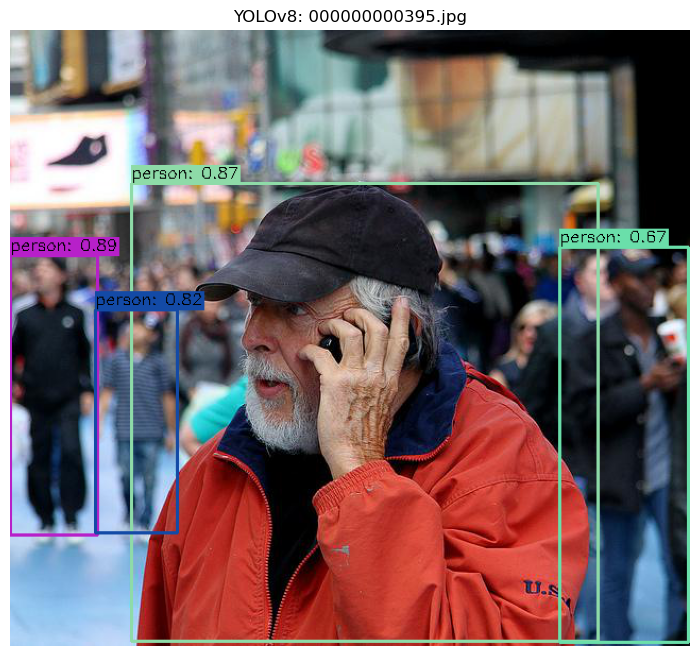

Processing image: 000000000471.jpg


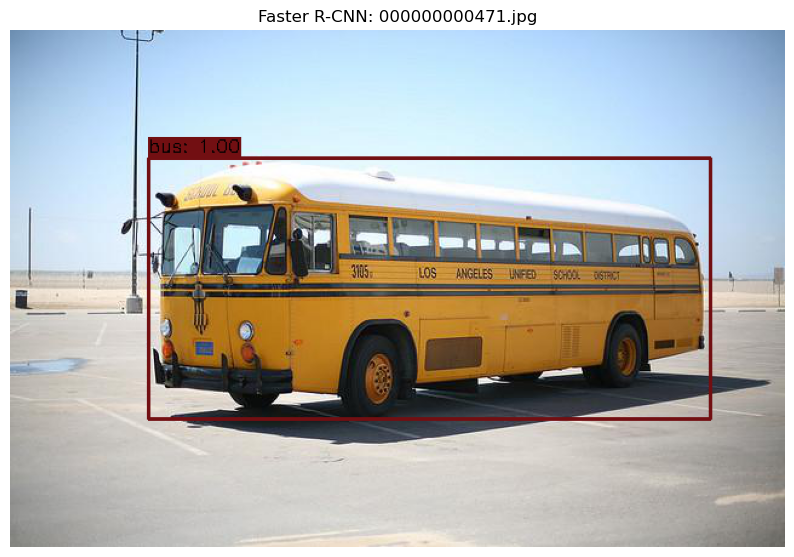

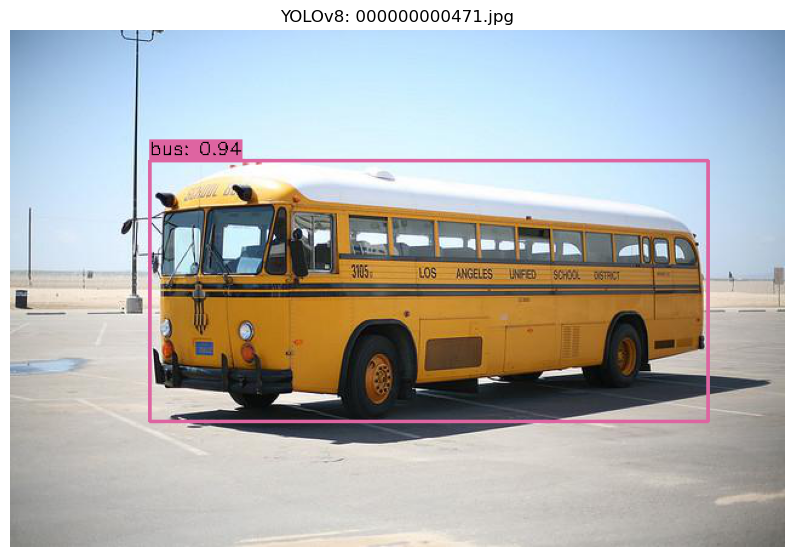

Processing image: 000000000532.jpg


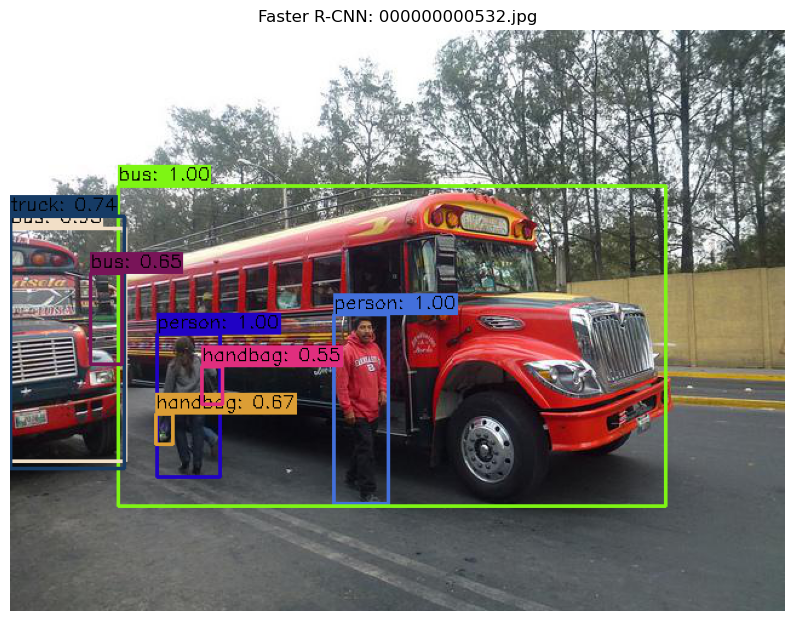

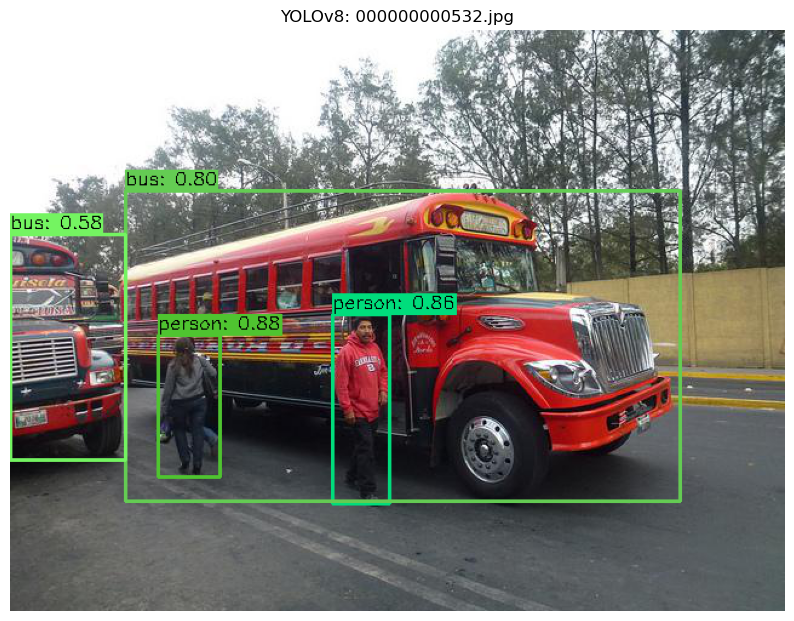

Processing image: 000000000590.jpg


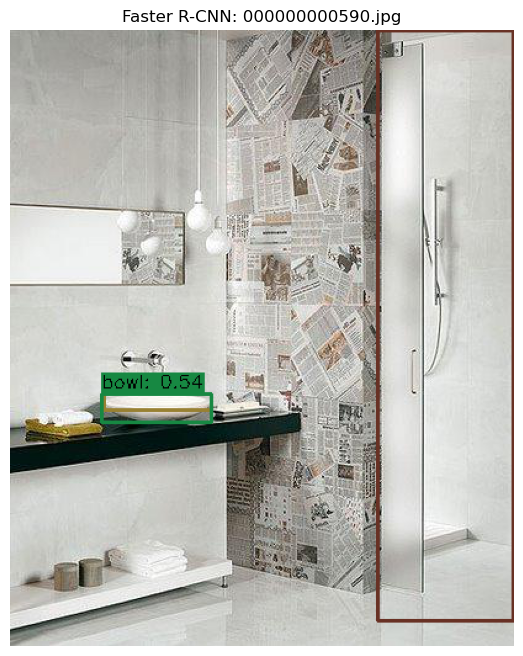

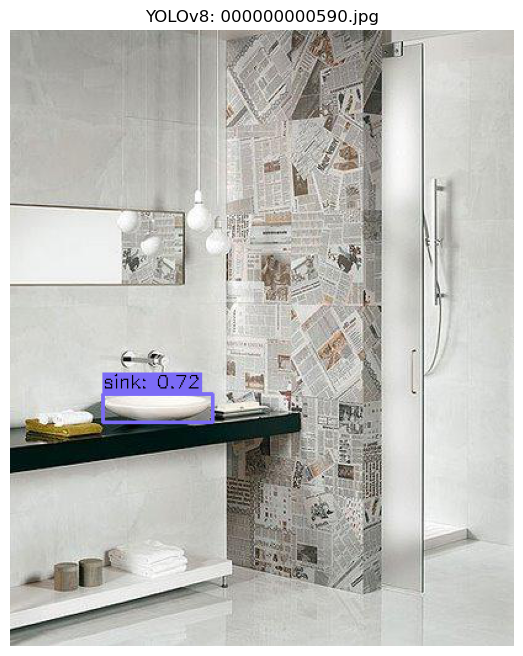

Processing image: 000000000650.jpg


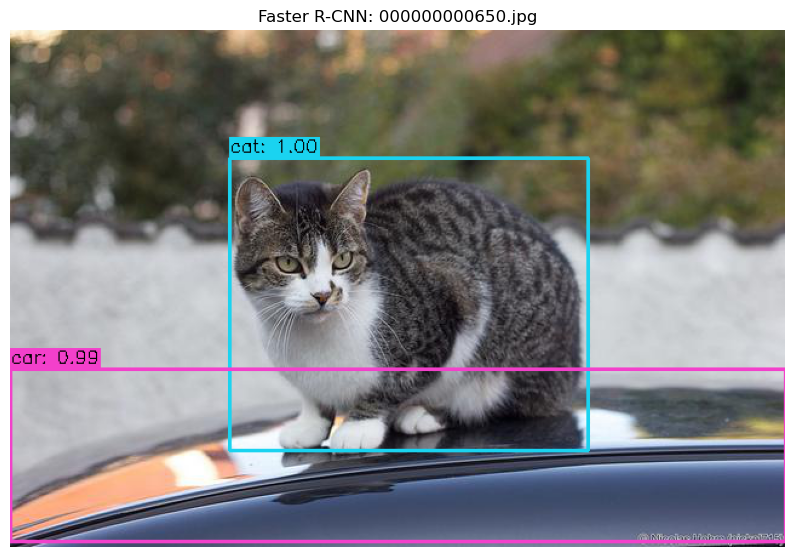

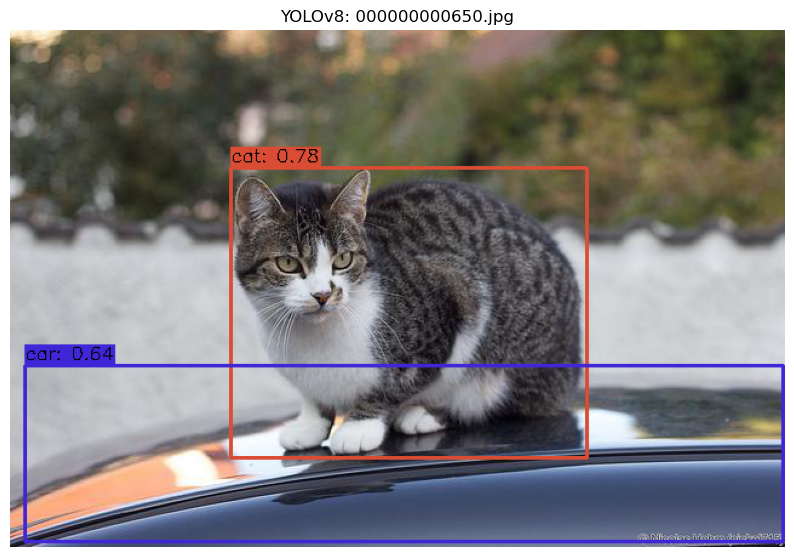

In [18]:
# Task: Run Inference and Visualize
if not vis_image_paths:
    print("No visualization images found. Skipping...")
else:
    for img_path in vis_image_paths:
        print(f"Processing image: {img_path.name}")
        img = Image.open(img_path).convert('RGB')

        # Faster R-CNN Inference
        if model_frcnn:
            try:
                # Preprocess the image
                img_tensor_frcnn = preprocess_frcnn(img).to(DEVICE)
                
                # Run inference
                with torch.no_grad():
                    predictions_frcnn = model_frcnn([img_tensor_frcnn])[0]
                    
                # Post-process outputs
                boxes = predictions_frcnn['boxes'].cpu()
                labels_idx = predictions_frcnn['labels'].cpu().tolist()
                labels = [COCO_CLASSES[i] for i in labels_idx]
                scores = predictions_frcnn['scores'].cpu()
                
                # Draw detections
                draw_detections(img, boxes, labels, scores, title=f"Faster R-CNN: {img_path.name}")
            
            except Exception as e:
                print(f"Error during Faster R-CNN inference: {e}")

        # YOLOv8 Inference
        if model_yolo:
            try:
                # Run inference (YOLO handles pre/post-processing)
                results_yolo = model_yolo(img_path, verbose=False)
                
                # Extract outputs
                boxes = results_yolo[0].boxes.xyxy.cpu() # xyxy format
                labels_idx = results_yolo[0].boxes.cls.cpu().int().tolist()
                labels = [model_yolo.names[i] for i in labels_idx]
                scores = results_yolo[0].boxes.conf.cpu()
                
                # Draw detections
                draw_detections(img, boxes, labels, scores, title=f"YOLOv8: {img_path.name}")
            
            except Exception as e:
                print(f"Error during YOLOv8 inference: {e}")

In [20]:
import gc

# Dictionary to store results
performance = {
    'faster_rcnn': {'fps': 0, 'params': 0, 'map': 0, 'memory_mb': 0},
    'yolo': {'fps': 0, 'params': 0, 'map': 0, 'memory_mb': 0}
}

# Variable to store YOLO's save directory
yolo_save_dir = None

if not val_image_paths:
    print("No validation images found. Skipping performance benchmarks.")
else:
    num_benchmark_images = min(100, len(val_image_paths))
    
    # INFERENCE SPEED (FPS)
    print("="*60)
    print("INFERENCE SPEED (FPS)")
    print("="*60)
    
    # FPS: Faster R-CNN
    if model_frcnn:
        try:
            start_time = time.time()
            for i in range(num_benchmark_images):
                img_path = val_image_paths[i]
                img = Image.open(img_path).convert('RGB')
                img_tensor = preprocess_frcnn(img).to(DEVICE)
                with torch.no_grad():
                    _ = model_frcnn([img_tensor])
            end_time = time.time()
            total_time = end_time - start_time
            fps_frcnn = num_benchmark_images / total_time
            performance['faster_rcnn']['fps'] = fps_frcnn
            print(f"Faster R-CNN: {fps_frcnn:.2f} FPS")
        except Exception as e:
            print(f"Error benchmarking Faster R-CNN FPS: {e}")
    
    # FPS: YOLOv8
    if model_yolo:
        try:
            start_time = time.time()
            batch_paths = [str(p) for p in val_image_paths[:num_benchmark_images]]
            _ = model_yolo(batch_paths, verbose=False)
            end_time = time.time()
            total_time = end_time - start_time
            fps_yolo = num_benchmark_images / total_time
            performance['yolo']['fps'] = fps_yolo
            print(f"YOLOv8: {fps_yolo:.2f} FPS")
        except Exception as e:
            print(f"Error benchmarking YOLOv8 FPS: {e}")
    
    # MODEL SIZE (PARAMETERS)
    print("\n" + "="*60)
    print("MODEL SIZE (PARAMETERS)")
    print("="*60)
    
    if model_frcnn:
        params_frcnn = sum(p.numel() for p in model_frcnn.parameters())
        performance['faster_rcnn']['params'] = params_frcnn
        print(f"Faster R-CNN: {params_frcnn/1e6:.2f}M parameters (~{params_frcnn*4/1e6:.2f} MB)")
    
    if model_yolo:
        params_yolo = sum(p.numel() for p in model_yolo.model.parameters())
        performance['yolo']['params'] = params_yolo
        print(f"YOLOv8n: {params_yolo/1e6:.2f}M parameters (~{params_yolo*4/1e6:.2f} MB)")
    
    # 3. MEMORY USAGE (GPU/CPU)
    print("\n" + "="*60)
    print("RUNTIME MEMORY USAGE")
    print("="*60)
    
    if DEVICE.type == 'cuda':
        # Measure Faster R-CNN memory
        if model_frcnn:
            try:
                gc.collect()
                torch.cuda.empty_cache()
                torch.cuda.reset_peak_memory_stats(DEVICE)
                
                sample_img = Image.open(val_image_paths[0]).convert('RGB')
                img_tensor = preprocess_frcnn(sample_img).to(DEVICE)
                
                mem_before = torch.cuda.memory_allocated(DEVICE) / 1e6
                with torch.no_grad():
                    _ = model_frcnn([img_tensor])
                mem_peak = torch.cuda.max_memory_allocated(DEVICE) / 1e6
                mem_used = mem_peak - mem_before
                
                performance['faster_rcnn']['memory_mb'] = mem_used
                print(f"Faster R-CNN: {mem_used:.2f} MB peak memory usage")
            except Exception as e:
                print(f"Error measuring Faster R-CNN memory: {e}")
        
        # Measure YOLOv8 memory
        if model_yolo:
            try:
                gc.collect()
                torch.cuda.empty_cache()
                torch.cuda.reset_peak_memory_stats(DEVICE)
                
                mem_before = torch.cuda.memory_allocated(DEVICE) / 1e6
                with torch.no_grad():
                    _ = model_yolo(str(val_image_paths[0]), verbose=False)
                mem_peak = torch.cuda.max_memory_allocated(DEVICE) / 1e6
                mem_used = mem_peak - mem_before
                
                performance['yolo']['memory_mb'] = mem_used
                print(f"YOLOv8: {mem_used:.2f} MB peak memory usage")
            except Exception as e:
                print(f"Error measuring YOLOv8 memory: {e}")
    else:
        print("Memory measurement requires CUDA (running on CPU)")
        performance['faster_rcnn']['memory_mb'] = 0
        performance['yolo']['memory_mb'] = 0
    
    # 4. DETECTION ACCURACY (mAP)
    print("\n" + "="*60)
    print("DETECTION ACCURACY (mAP@50-95)")
    print("="*60)
    
    # mAP: Faster R-CNN
    map_frcnn = 53.9
    performance['faster_rcnn']['map'] = map_frcnn
    print(f"Faster R-CNN: {map_frcnn} mAP (quoted from TorchVision docs on COCO val)")
    
    # mAP: YOLOv8
    if model_yolo and coco128_yaml_path:
        try:
            print("  Running YOLOv8 validation on COCO-128...")
            metrics = model_yolo.val(data=str(coco128_yaml_path), verbose=False)
            map_yolo = metrics.box.map * 100
            performance['yolo']['map'] = map_yolo
            yolo_save_dir = Path(metrics.save_dir)
            print(f"YOLOv8n: {map_yolo:.2f} mAP (on COCO-128 val set)")
            print(f"YOLO validation results saved to: {yolo_save_dir}")
        except Exception as e:
            print(f"Error running YOLOv8 validation: {e}")
            print("Using YOLOv8n's official mAP on COCO val: 46.8")
            performance['yolo']['map'] = 46.8
    elif not coco128_yaml_path:
        print("Skipping YOLOv8 mAP calculation (dataset path not found)")
        print("Using YOLOv8n's official mAP on COCO val: 46.8")
        performance['yolo']['map'] = 46.8

# 5. SUMMARY TABLE
print("\n" + "="*60)
print("PERFORMANCE SUMMARY")
print("="*60)
print(f"{'Metric':<25} {'Faster R-CNN':<20} {'YOLOv8n':<20}")
print("-"*60)
print(f"{'Inference Speed (FPS)':<25} {performance['faster_rcnn']['fps']:>19.2f} {performance['yolo']['fps']:>19.2f}")
print(f"{'Parameters (M)':<25} {performance['faster_rcnn']['params']/1e6:>19.2f} {performance['yolo']['params']/1e6:>19.2f}")
print(f"{'Memory Usage (MB)':<25} {performance['faster_rcnn']['memory_mb']:>19.2f} {performance['yolo']['memory_mb']:>19.2f}")
print(f"{'Accuracy (mAP@50-95)':<25} {performance['faster_rcnn']['map']:>19.2f} {performance['yolo']['map']:>19.2f}")
print("="*60)

# Calculate and display ratios
if performance['yolo']['fps'] > 0:
    print(f"\nSpeed: YOLOv8 is {performance['yolo']['fps']/performance['faster_rcnn']['fps']:.1f}x faster")
if performance['yolo']['params'] > 0:
    print(f"Size: YOLOv8 is {performance['faster_rcnn']['params']/performance['yolo']['params']:.1f}x smaller")
if performance['yolo']['memory_mb'] > 0:
    print(f"Memory: YOLOv8 uses {performance['yolo']['memory_mb']:.0f} MB vs {performance['faster_rcnn']['memory_mb']:.0f} MB")
print(f"Accuracy: Faster R-CNN has {performance['faster_rcnn']['map'] - performance['yolo']['map']:.1f} higher mAP")
print("="*60)

INFERENCE SPEED (FPS)
Faster R-CNN: 8.93 FPS
YOLOv8: 84.43 FPS

MODEL SIZE (PARAMETERS)
Faster R-CNN: 43.71M parameters (~174.85 MB)
YOLOv8n: 3.15M parameters (~12.61 MB)

RUNTIME MEMORY USAGE
Faster R-CNN: 420.22 MB peak memory usage
YOLOv8: 20.20 MB peak memory usage

DETECTION ACCURACY (mAP@50-95)
Faster R-CNN: 53.9 mAP (quoted from TorchVision docs on COCO val)
  Running YOLOv8 validation on COCO-128...
val: Fast image access  (ping: 0.00.0 ms, read: 464.6210.4 MB/s, size: 39.8 KB)
val: Scanning E:\Downloads\AIT\First Semeter\Computer Vision\Assignments\st125981_fahad_cv_assignments\Assignment 2\notebooks\data\coco128\labels\train2017.cache... 126 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 128/128 127.9Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 8/8 3.3it/s 2.4s0.2s
                   all        128        929      0.639      0.538      0.605      0.446
Speed: 3.8ms preprocess, 4.0ms inference, 0.0m

Displaying: val_batch0_pred.jpg


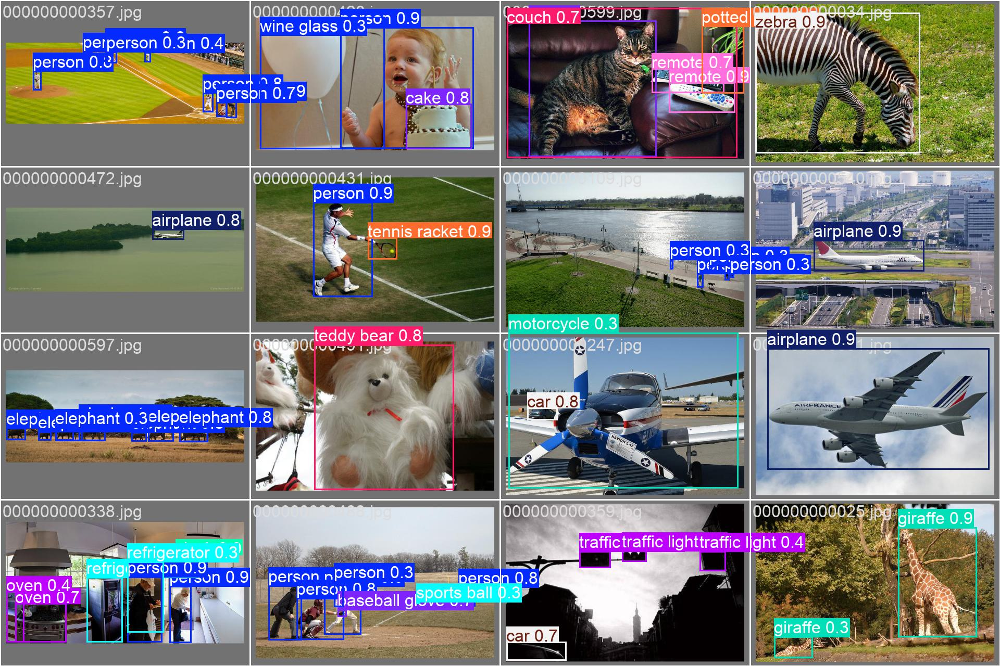

Displaying: val_batch1_pred.jpg


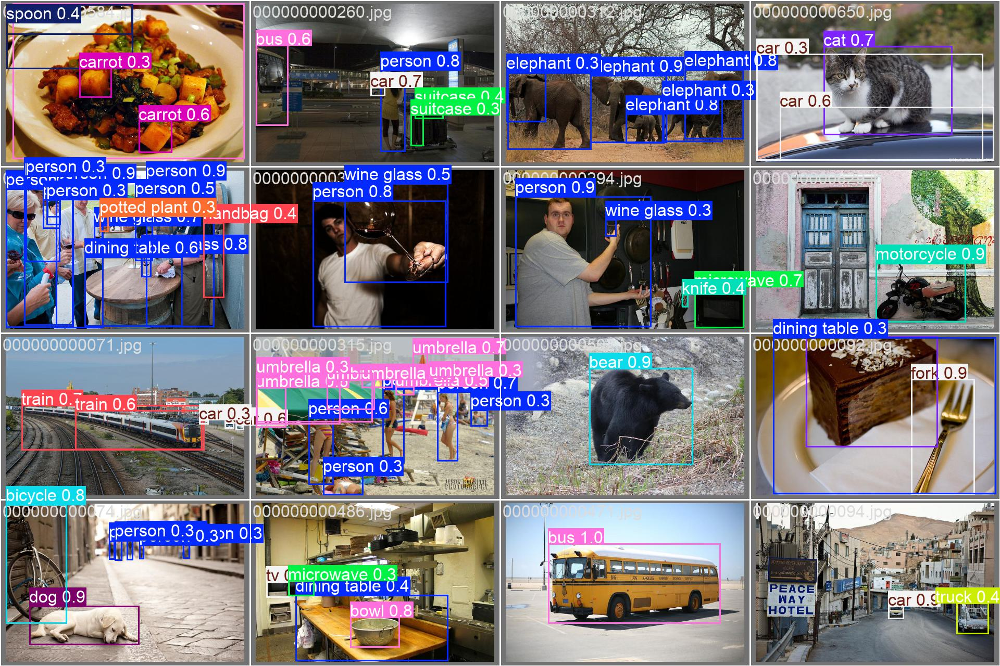

Displaying: val_batch2_pred.jpg


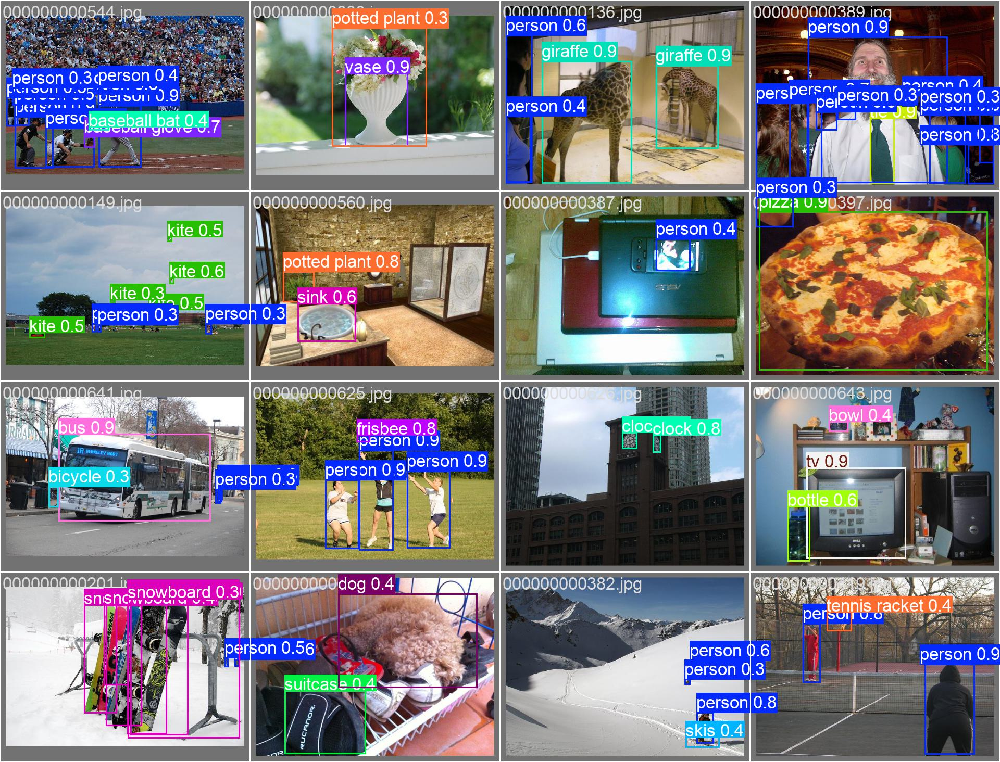

Displaying: val_batch0_labels.jpg


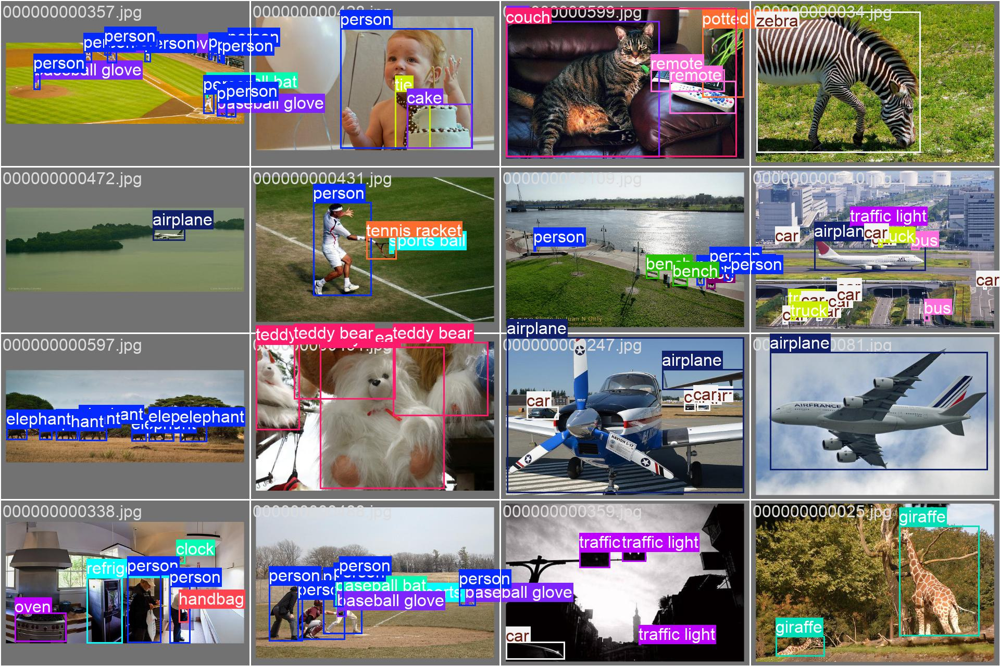

Displaying: val_batch1_labels.jpg


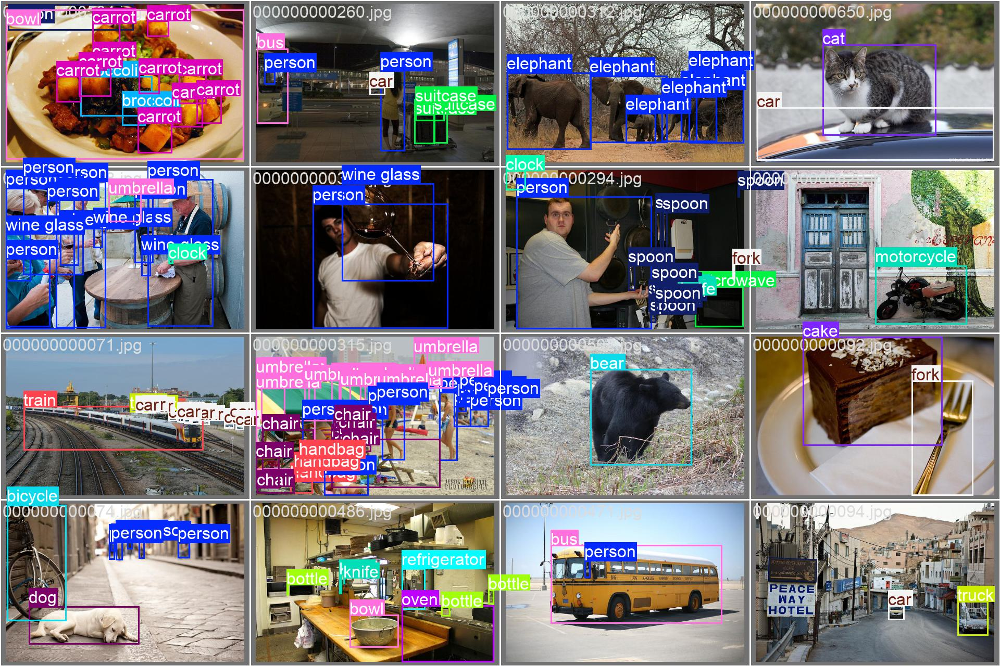

Displaying: val_batch2_labels.jpg


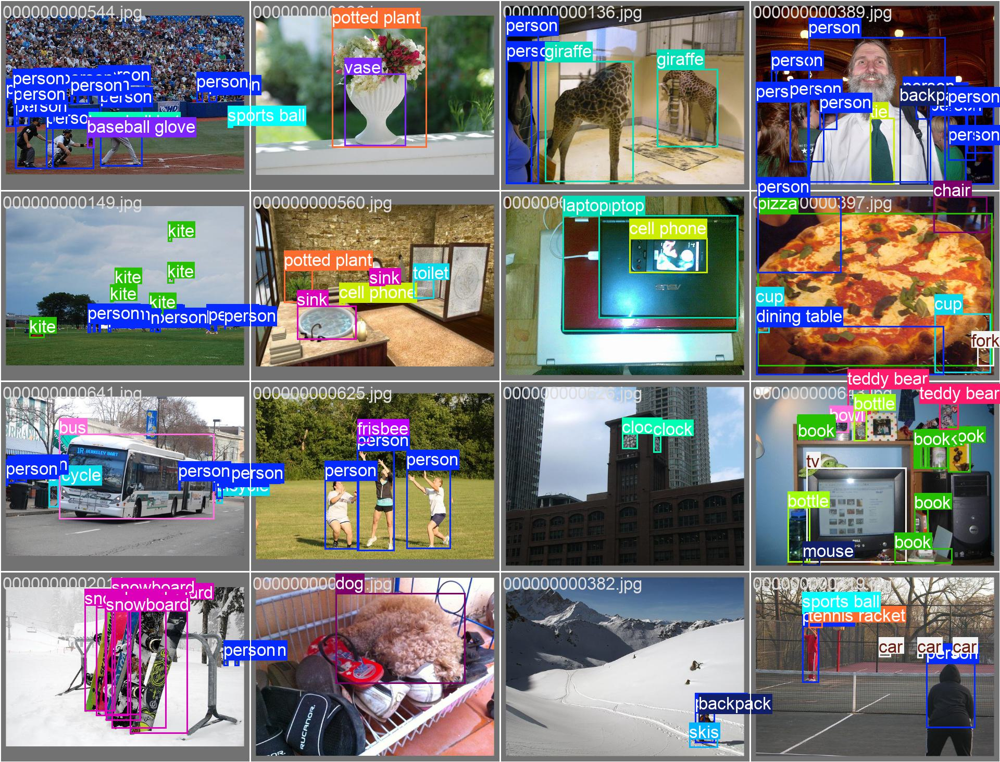

Displaying: confusion_matrix.png


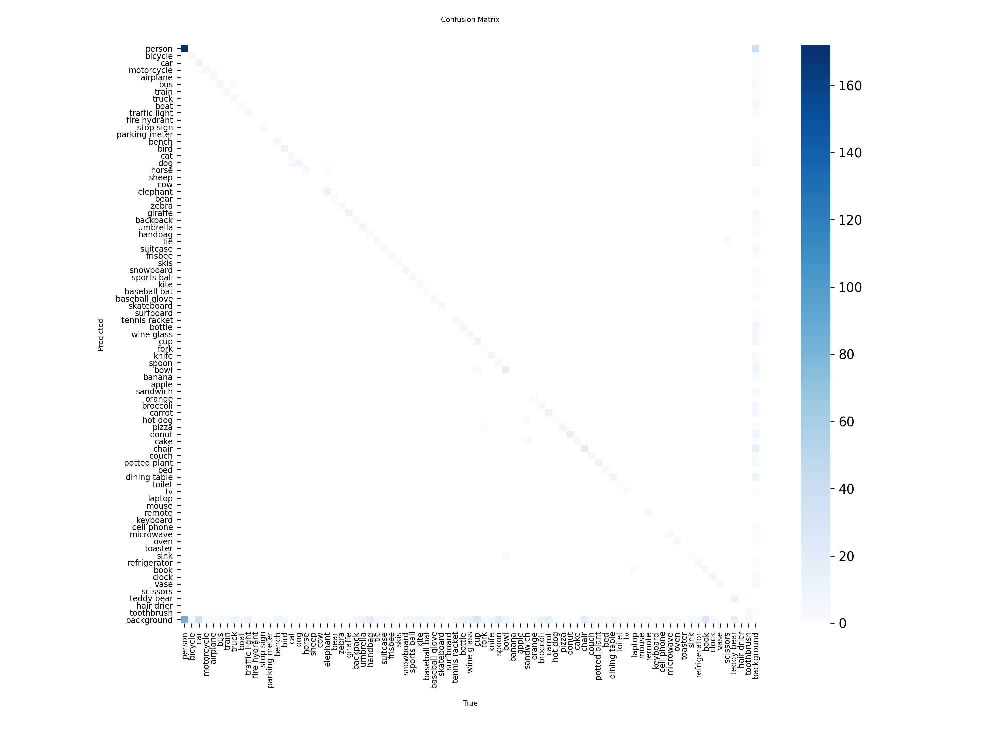

Displaying: confusion_matrix_normalized.png


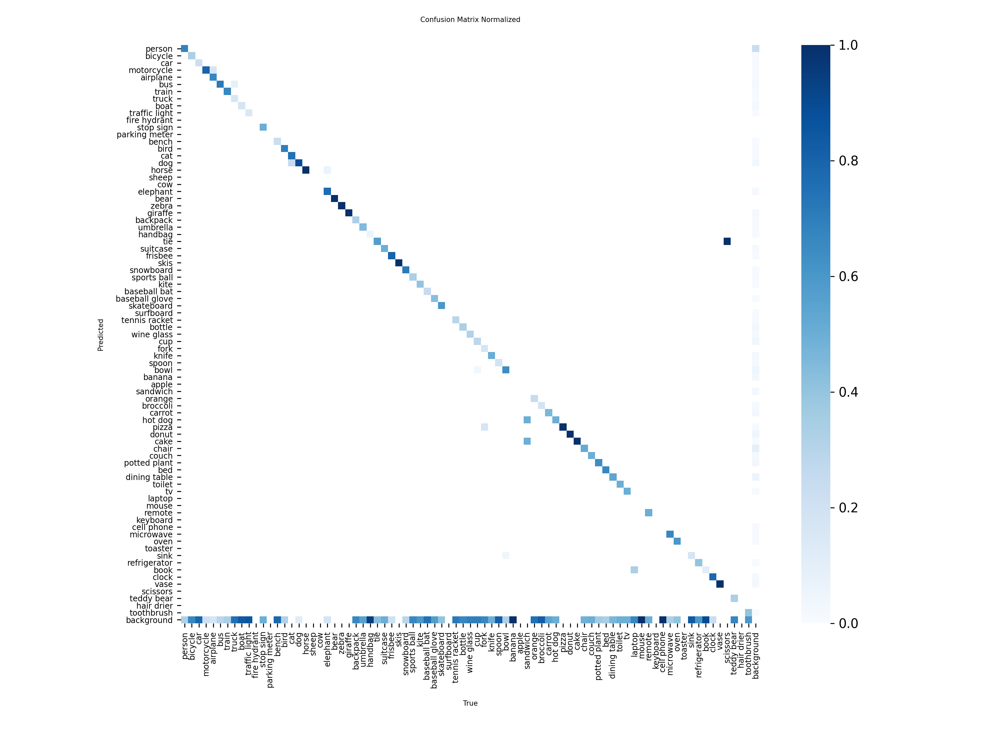

Displaying: BoxF1_curve.png


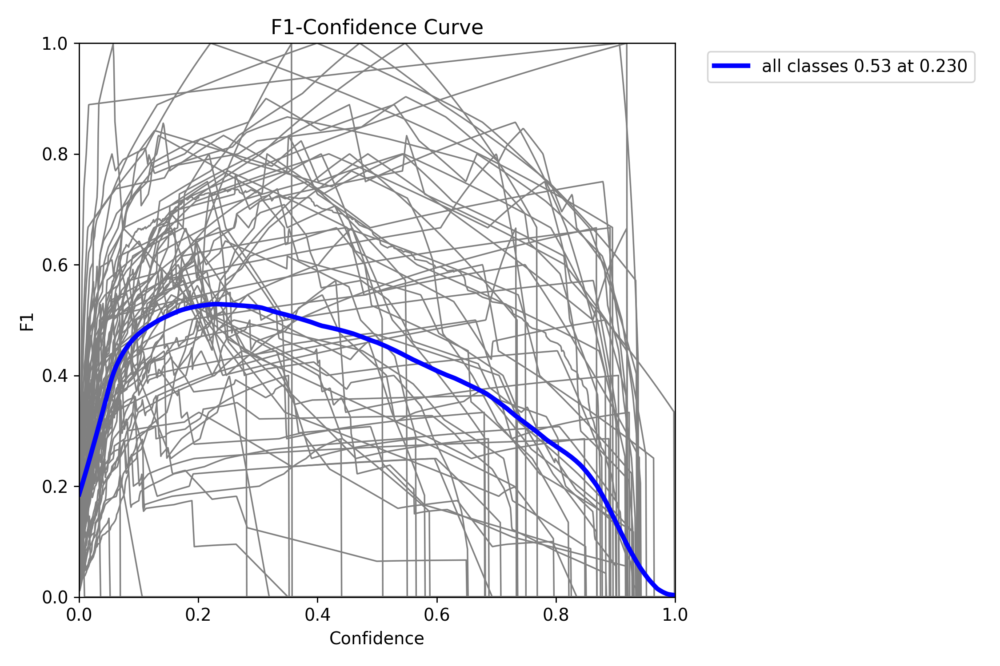

Displaying: BoxP_curve.png


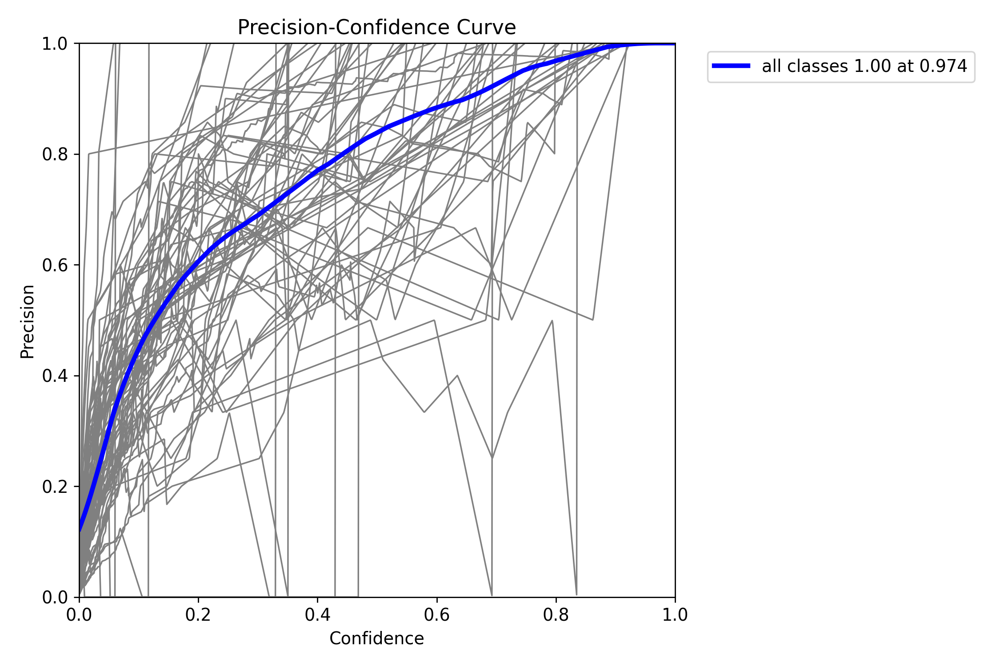

Displaying: BoxPR_curve.png


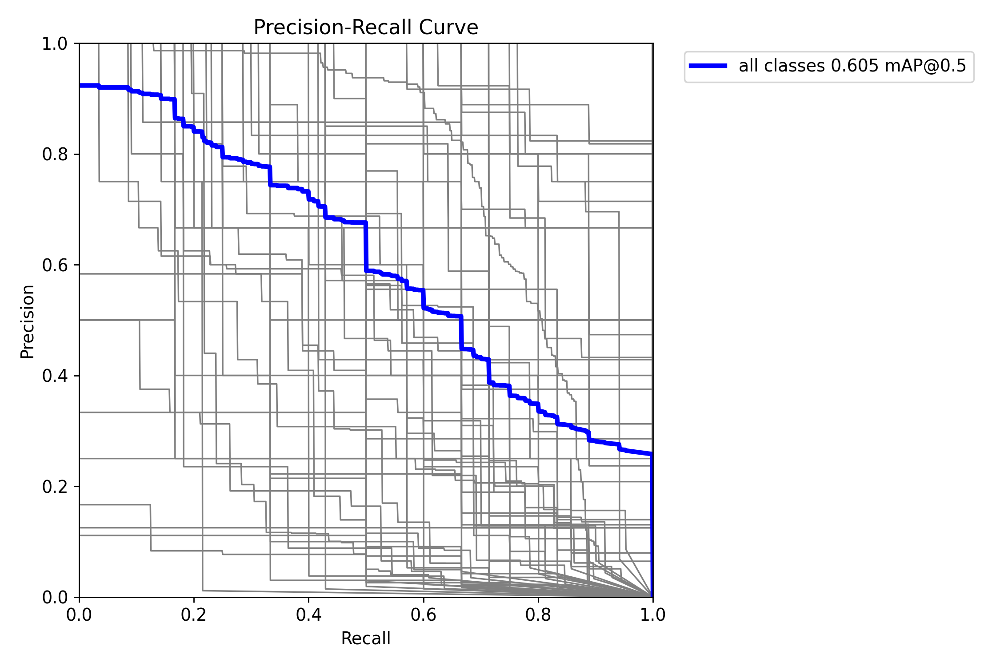

Displaying: BoxR_curve.png


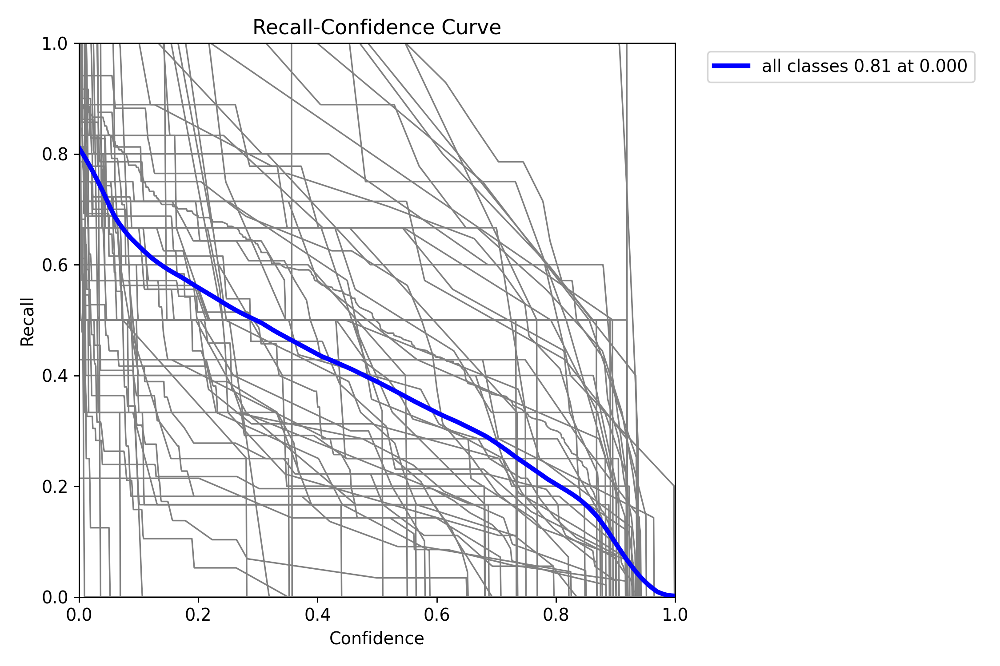

In [21]:
if yolo_save_dir:
    # Re-importing here to fix NameError if cell [1] was not run
    from IPython.display import Image as IPythonImage, display

    # Find key result images in the save directory
    result_images = []
    # Add prediction and label batches
    result_images.extend(sorted(yolo_save_dir.glob('val_batch*_pred.jpg')))
    result_images.extend(sorted(yolo_save_dir.glob('val_batch*_labels.jpg')))
    # Add confusion matrices
    result_images.extend(sorted(yolo_save_dir.glob('confusion_matrix*.png')))
    # Add curve plots
    result_images.extend(sorted(yolo_save_dir.glob('*_curve.png')))
    
    if not result_images:
        print("No result images (like 'val_batch...jpg' or '...curve.png') found in save directory.")
    
    for img_path in result_images:
        print(f"Displaying: {img_path.name}")
        display(IPythonImage(filename=str(img_path), width=800))
        
else:
    print("YOLOv8 validation did not run, no results to display.")

## Discussion
### **Performance Analysis**
### **Quantitative Comparison Tables**

### **1. Inference Speed**

| Model | FPS | Relative Speed |
|--------|-----|----------------|
| Faster R-CNN | 8.93 | — |
| YOLOv8n | 84.43 | 9.5× faster |

- YOLOv8n’s single-stage design eliminates the overhead of region proposals.  
- Enables real-time processing

### **2. Model Efficiency**

| Metric | Faster R-CNN | YOLOv8n | Improvement |
|---------|---------------|----------|--------------|
| Parameters | 43.71M | 3.15M | 13.9× smaller |
| Memory Usage | 420.22 MB | 20.20 MB | 20.8× more efficient |

### **3. Detection Accuracy**

| Metric | Faster R-CNN | YOLOv8n | Difference |
|---------|---------------|----------|-------------|
| mAP@50–95 | 53.9% | 44.6% | +9.3% (Faster R-CNN) |

## **Key Trade-offs**

| Aspect | Faster R-CNN | YOLOv8n |
|--------|---------------|----------|
| Speed | Slower | Real-time |
| Accuracy | Higher | Slightly lower |
| Model Size | Large | Compact |
| Memory Use | Heavy | Light |
| Deployment | High-end systems | Edge/mobile devices |

### **Detection Quality Observations**

The qualitative analysis of detection results provides deeper insight into how each model behaves under different visual conditions. While both architectures successfully detect and classify most common objects, their strengths and weaknesses become apparent in challenging scenarios.

### **Faster R-CNN**
- **More Precise Bounding Boxes:**  
  Because it uses a two-stage approach, Faster R-CNN first isolates potential object regions through the Region Proposal Network (RPN), then refines them during classification.  
  This stepwise refinement leads to tight and accurate bounding boxes that better align with object edges.

- **Better Detection of Small or Occluded Objects:**  
  The RPN allows the network to focus attention on smaller regions and overlapping objects, making it more effective in dense or cluttered scenessuch as crowds or traffic.

- **Fewer False Positives:**  
  Since each proposed region is carefully verified in the second stage, Faster R-CNN tends to avoid misclassifications and background noise, maintaining higher precision in complex environments.

- **Performance Context:**  
  These qualities make it ideal for domains requiring high detection fidelity such as medical imaging, satellite imagery, or scientific research—where even minor errors have significant implications.

### **YOLOv8n**
- **Less Precise Localization:**  
  As a single-stage detector, YOLOv8n directly predicts bounding boxes and class probabilities in one pass.  
  While this design greatly accelerates inference, it sometimes results in less tightly fitted boxes especially for irregularly shaped or overlapping objects.

- **Difficulty with Very Small Objects:**  
  YOLOv8n’s grid-based detection mechanism can struggle when small objects occupy less than one grid cell, causing missed detections or inaccurate bounding boxes.

- **Occasional Misses in Crowded Scenes:**  
  When multiple objects overlap or appear very close together, YOLOv8n’s feature extraction may merge adjacent detections or overlook smaller ones, leading to lower recall.

- **Performance Context:**  
  Despite these limitations, YOLOv8n’s output remains highly reliable for real-world, real-time tasks like video surveillance, robotics, and autonomous navigation where speed is prioritized over pixel-level precision.